In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt

from scipy import stats
from utils.print import print_block
from data.dataset import REFLACXWithClinicalDataset
from utils.gradcam import get_df_label_pred_img_input_loss, show_gradCAMpp_result

from tqdm.notebook import tqdm
from utils.plot import relabel_ellipse_df, get_ellipses_patch
from utils.transform import TransformFuncs
from copy import copy
import numpy as np
from sklearn.metrics import accuracy_score, roc_auc_score, confusion_matrix, ConfusionMatrixDisplay
import torch
from model.xami import XAMIMultiCocatModal
from utils.gradcam import get_df_label_pred_img_input_loss, show_gradCAMpp_result
from utils.train import get_aus_loss



In [2]:
pd.options.mode.chained_assignment = None

# checking if the GPU is available
use_gpu = torch.cuda.is_available()
device = 'cuda' if use_gpu else 'cpu'
print(f"Will be using {device}")

Will be using cuda


In [3]:
reflacx_dataset = REFLACXWithClinicalDataset(image_size=256)

Positive Loss weight:
[0.768546   0.78635013 0.7937685  0.8338279  0.87388724]
Negative Loss weight:
[0.231454   0.21364985 0.20623146 0.1661721  0.12611276]
Random Loss:
0.21026036153991162


In [4]:
cxr_prefix = "cxr"
cxr_clinical_prefix ="cxr_clinical"

cxr_model_name = 'test_0_8162_epoch300_WithoutClincal_dim32_2022-02-07 21_43_31_353207'
cxr_clinical_model_name = 'test_0_8260__epoch300_WithClincal_dim32_2022-02-08 10_03_56_953198'

In [5]:
cxr_dfs = []
cxr_clinical_dfs = []

for id in list(reflacx_dataset.df['id']):
    cxr_dfs.append(pd.read_csv(os.path.join(f"{cxr_model_name}_result", id, 'df.csv'), index_col=0))
    cxr_clinical_dfs.append(pd.read_csv(os.path.join(f"{cxr_clinical_model_name}_result", id, 'df.csv'), index_col=0))    

In [6]:
cxr_dfs = pd.concat(cxr_dfs, axis=0)
cxr_clinical_df = pd.concat(cxr_clinical_dfs, axis=0)

In [7]:
cxr_dfs.columns

Index(['index', 'id', 'dicom_id', 'subject_id', 'stay_id', 'study_id', 'split',
       'image_path', 'ViewPosition', 'image_size_x', 'image_size_y',
       'anomaly_location_ellipses_path', 'age', 'gender', 'temperature',
       'heartrate', 'resprate', 'o2sat', 'sbp', 'dbp', 'pain', 'acuity',
       'Airway wall thickening', 'Atelectasis', 'Consolidation',
       'Enlarged cardiac silhouette', 'Fibrosis', 'Groundglass opacity',
       'Other', 'Pneumothorax', 'Pulmonary edema', 'Quality issue',
       'Support devices', 'Wide mediastinum', 'Abnormal mediastinal contour',
       'Acute fracture', 'Enlarged hilum', 'Hiatal hernia',
       'High lung volume / emphysema', 'Interstitial lung disease',
       'Lung nodule or mass', 'Pleural abnormality',
       'pred_Enlarged cardiac silhouette', 'pred_Atelectasis',
       'pred_Pleural abnormality', 'pred_Consolidation',
       'pred_Pulmonary edema', 'loss'],
      dtype='object')

In [8]:
all_pred_cols = [ f"pred_{col}"  for col in reflacx_dataset.labels_cols]
cxr_rename_map = {}
for pred_col in all_pred_cols:
    cxr_rename_map[pred_col] = f"{cxr_prefix}_{pred_col}"

cxr_rename_map['loss'] = f'{cxr_prefix}_loss'

In [9]:
combined_df = cxr_dfs.rename(cxr_rename_map,axis=1)

In [10]:
for pred_col in all_pred_cols:
    combined_df[f'{cxr_clinical_prefix}_{pred_col}'] = cxr_clinical_df[pred_col]

combined_df[f'{cxr_clinical_prefix}_loss'] = cxr_clinical_df['loss']

In [11]:
combined_df[f'{cxr_prefix}_accuracy'] = combined_df.apply(lambda x: accuracy_score(
    np.array(x[[f"{col}" for col in reflacx_dataset.labels_cols]]).astype('long'),
    (np.array(x[[f"{cxr_prefix}_{col}" for col in all_pred_cols]]) > 0.5).astype('long'),
), axis=1)


combined_df[f'{cxr_clinical_prefix}_accuracy'] = combined_df.apply(lambda x: accuracy_score(
    np.array(x[[f"{col}" for col in reflacx_dataset.labels_cols]]).astype('long'),
    (np.array(x[[f"{cxr_clinical_prefix}_{col}" for col in all_pred_cols]]) > 0.5).astype('long'),
), axis=1)

In [12]:
combined_df.head(5)

,index,id,dicom_id,subject_id,stay_id,study_id,split,image_path,ViewPosition,image_size_x,...,cxr_pred_Pulmonary edema,cxr_loss,cxr_clinical_pred_Enlarged cardiac silhouette,cxr_clinical_pred_Atelectasis,cxr_clinical_pred_Pleural abnormality,cxr_clinical_pred_Consolidation,cxr_clinical_pred_Pulmonary edema,cxr_clinical_loss,cxr_accuracy,cxr_clinical_accuracy
0,0,P102R108387,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,18111516,32067002,55032240,train,D:\XAMI-MIMIC\patient_18111516\CXR-JPG\s550322...,AP,2544,...,0.075871,0.874296,0.967592,0.145157,0.042499,0.010186,0.195144,0.729233,0.8,1.0
0,1,P102R379837,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,18111516,32067002,55032240,train,D:\XAMI-MIMIC\patient_18111516\CXR-JPG\s550322...,AP,2544,...,0.075871,0.874296,0.967592,0.145157,0.042499,0.010186,0.195144,0.729233,0.8,1.0
0,2,P102R558314,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,18111516,32067002,55032240,train,D:\XAMI-MIMIC\patient_18111516\CXR-JPG\s550322...,AP,2544,...,0.075871,0.874296,0.967592,0.145157,0.042499,0.010186,0.195144,0.729233,0.8,1.0
0,3,P102R765317,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,18111516,32067002,55032240,train,D:\XAMI-MIMIC\patient_18111516\CXR-JPG\s550322...,AP,2544,...,0.075871,0.372869,0.967592,0.145157,0.042499,0.010186,0.195144,0.226389,0.6,0.8
0,4,P102R915878,34cedb74-d0996b40-6d218312-a9174bea-d48dc033,18111516,32067002,55032240,train,D:\XAMI-MIMIC\patient_18111516\CXR-JPG\s550322...,AP,2544,...,0.075871,0.874296,0.967592,0.145157,0.042499,0.010186,0.195144,0.729233,0.8,1.0


In [13]:
# get the best and worst cases.

cxr_highest_loss_idxs = [list(reflacx_dataset.df.index).index(idx)  for idx in list(combined_df.sort_values(
    f'{cxr_prefix}_loss', ascending=False)[:5]["index"])]


cxr_lowest_accuracy_idxs = [list(reflacx_dataset.df.index).index(idx) for idx in list(combined_df.sort_values(
    f'{cxr_prefix}_accuracy', ascending=True)[:5]["index"])]


cxr_clinical_highest_loss_idxs = [list(reflacx_dataset.df.index).index(idx)  for idx in list(combined_df.sort_values(
    f'{cxr_clinical_prefix}_loss', ascending=False)[:5]["index"])]


cxr_clinical_lowest_accuracy_idxs = [list(reflacx_dataset.df.index).index(idx) for idx in list(combined_df.sort_values(
    f'{cxr_clinical_prefix}_accuracy', ascending=True)[:5]["index"])]

In [14]:
# load models

cxr_model = XAMIMultiCocatModal(
    reflacx_dataset,
    device,
    use_clinical=False,
    model_dim=32, # was 64
    embeding_dim=64,
    dropout=.2,  # increase the dropout rate did improve the regularization.
    pretrained=True
)
cxr_model.load_state_dict(torch.load(os.path.join('saved_models', cxr_model_name ), map_location=device))
cxr_model.to(device)


cxr_clinical_model = XAMIMultiCocatModal(
    reflacx_dataset,
    device,
    use_clinical=True,
    model_dim=32, # was 64
    embeding_dim=64,
    dropout=.2,  # increase the dropout rate did improve the regularization.
    pretrained=True
)
cxr_clinical_model.load_state_dict(torch.load(os.path.join('saved_models', cxr_clinical_model_name), map_location=device))
cxr_clinical_model.to(device)


# load loss function
loss_fn = get_aus_loss(reflacx_dataset)


In [15]:
best_worst_cases = {}

top_num = 5

for col in reflacx_dataset.labels_cols:
    best_worst_cases[col] ={}

    best_worst_cases[col][f'{cxr_prefix}_best']= [list(reflacx_dataset.df.index).index(idx) for idx in list((combined_df[combined_df[col]].sort_values(f"{cxr_prefix}_pred_{col}", ascending=False))[:top_num]["index"])]

    best_worst_cases[col][f'{cxr_prefix}_worst']= [list(reflacx_dataset.df.index).index(idx) for idx in list((combined_df[combined_df[col]].sort_values(f"{cxr_prefix}_pred_{col}", ascending=True))[:top_num]["index"])]

    best_worst_cases[col][f'{cxr_clinical_prefix}_best']= [list(reflacx_dataset.df.index).index(idx) for idx in list((combined_df[combined_df[col]].sort_values(f"{cxr_clinical_prefix}_pred_{col}", ascending=False))[:top_num]["index"])]

    best_worst_cases[col][f'{cxr_clinical_prefix}_worst']= [list(reflacx_dataset.df.index).index(idx) for idx in list((combined_df[combined_df[col]].sort_values(f"{cxr_clinical_prefix}_pred_{col}", ascending=True))[:top_num]["index"])]



In [16]:
def jpg_to_dicom_path(jpg_path):
    return jpg_path.replace("CXR-JPG", "CXR-DICOM").replace('.jpg', '.dcm')

In [17]:
def calculate_ellipses_for_case(df, disease, model_input_image_size):
    ellipse_df = pd.read_csv(df['anomaly_location_ellipses_path'].iloc[0])
    relabeled_ellipse_df = relabel_ellipse_df(ellipse_df)
    image_size_x = df.iloc[0]['image_size_x']
    image_size_y = df.iloc[0]['image_size_y']
    return get_ellipses_patch(relabeled_ellipse_df, disease, image_size_x, image_size_y, model_input_image_size)

In [24]:
def plot_best_worst(combined_df, dataset, model, model_prefix, case_affix,top_num, best_worst_cases,loss_fn, device):

    model_input_image_size = dataset.image_size

    transform_func = TransformFuncs(image_size=model_input_image_size)

    for d in best_worst_cases.keys():

        ## plot the cases for cxr
        fig, subplots = plt.subplots(top_num, 2, figsize=(20, 40))

        ## plot
        for i, idx in enumerate(best_worst_cases[d][f'{model_prefix}_{case_affix}']):

            df, labels_df, pred_df, img, loss, model_input = get_df_label_pred_img_input_loss(model, loss_fn,       reflacx_dataset, idx, device)

            ellipes = calculate_ellipses_for_case(df, d, model_input_image_size)
            gradcam_img = show_gradCAMpp_result(reflacx_dataset, model, d, img, model_input,      use_full_features=True)

            subplots[i, 0].imshow(transform_func.display_transform(img))
            # subplots[i, 0].set_title(f'{d} (label={combined_df.iloc[idx][d]}) ({case_affix} #{i+1})')
            subplots[i, 0].set_title(jpg_to_dicom_path(df.iloc[0]['image_path']).replace("D:\\", ""))


            subplots[i, 1].imshow(gradcam_img)
            subplots[i, 1].set_title(f'{d} (pred={combined_df.iloc[idx][f"{model_prefix}_pred_{d}"]:.4f}) ({case_affix} #{i+1})')

            for e in ellipes:
                subplots[i, 1].add_patch(copy(e))

    plt.show()


# Best Cases for CXR model

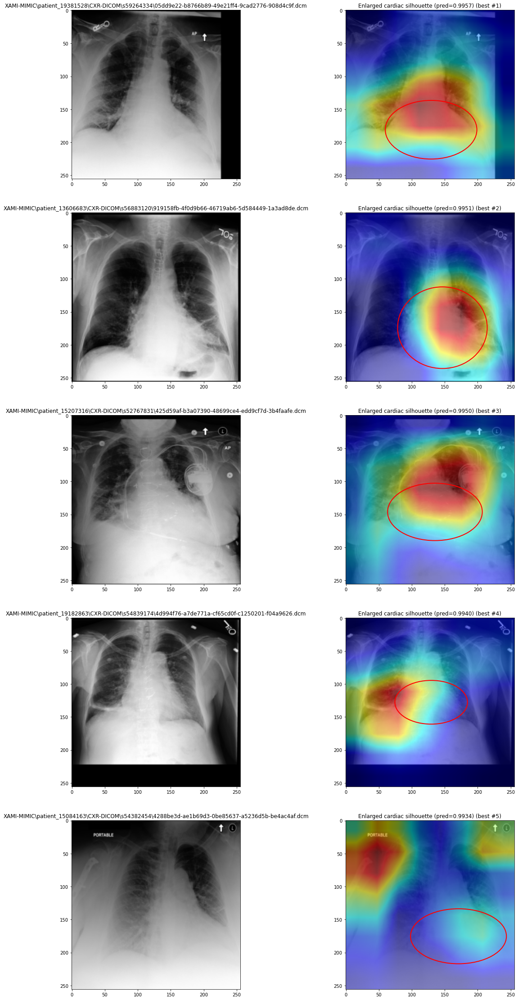

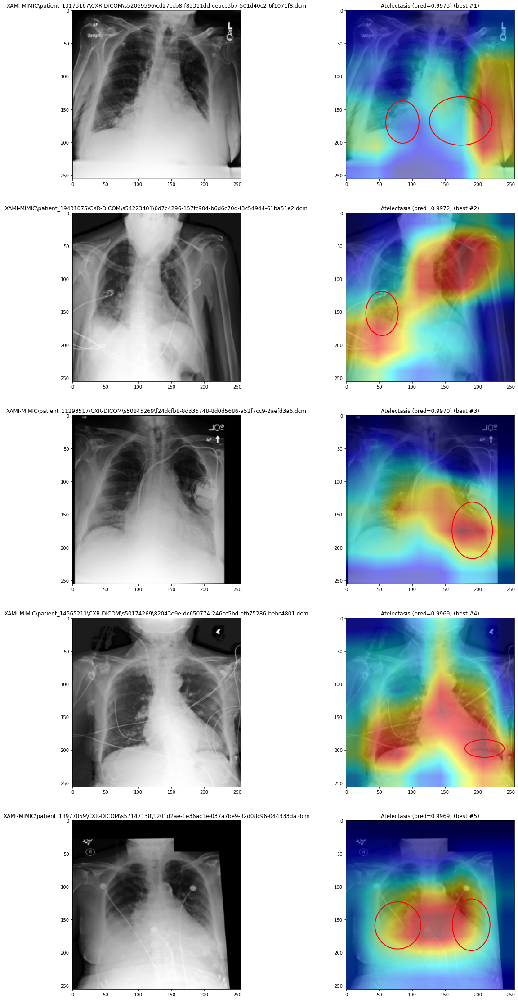

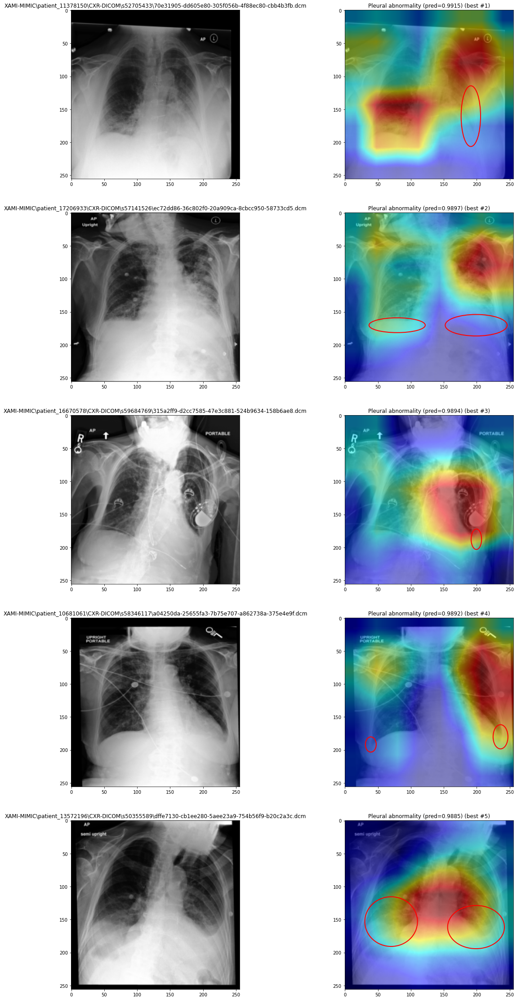

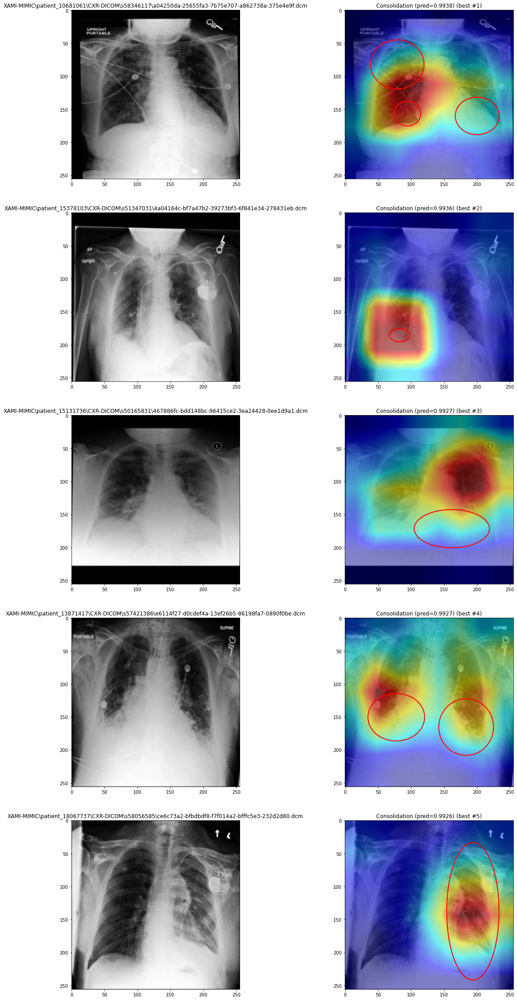

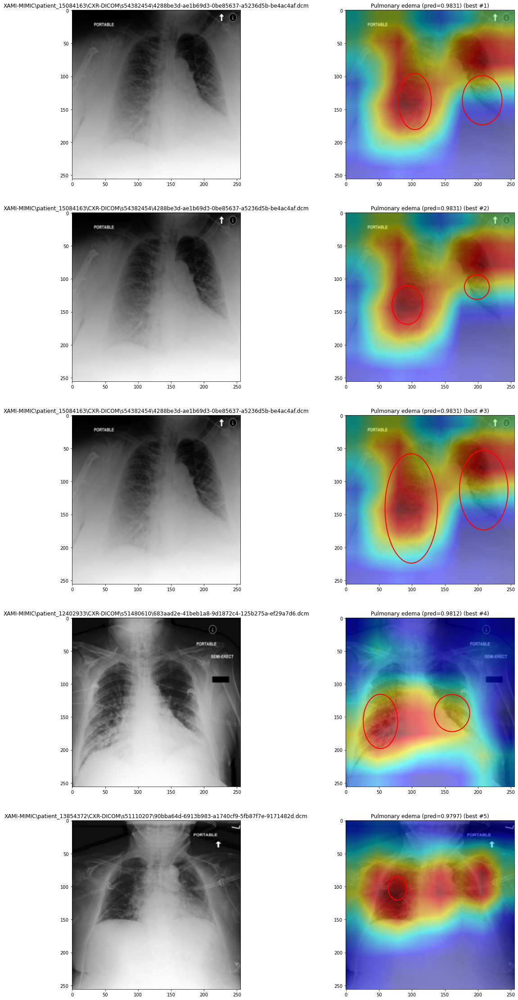

In [25]:
plot_best_worst(combined_df, reflacx_dataset, cxr_model, cxr_prefix,
                "best", top_num, best_worst_cases, loss_fn, device)


# Worst Cases for CXR model

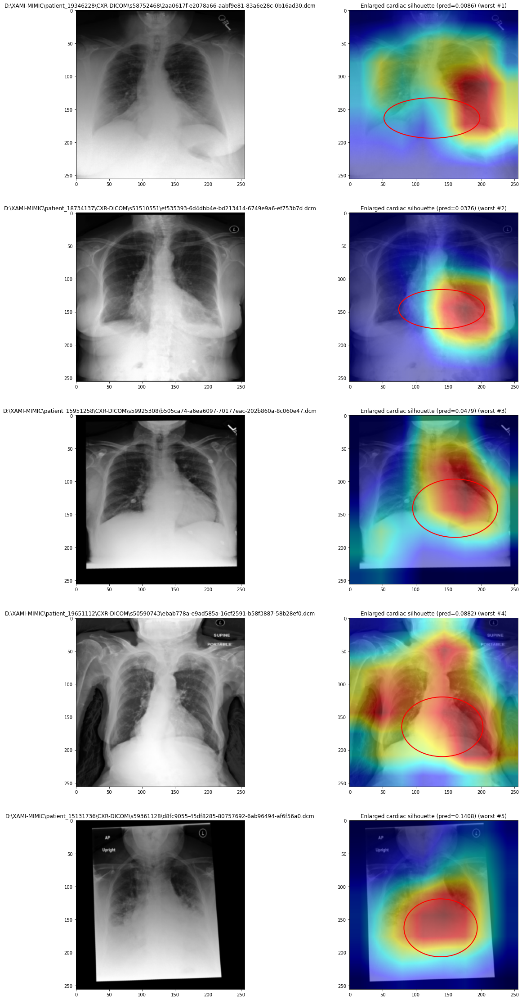

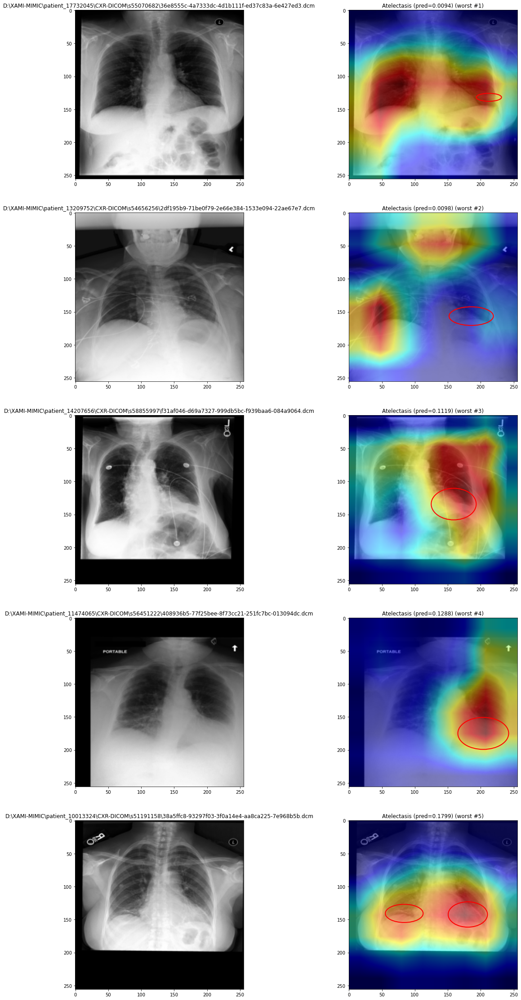

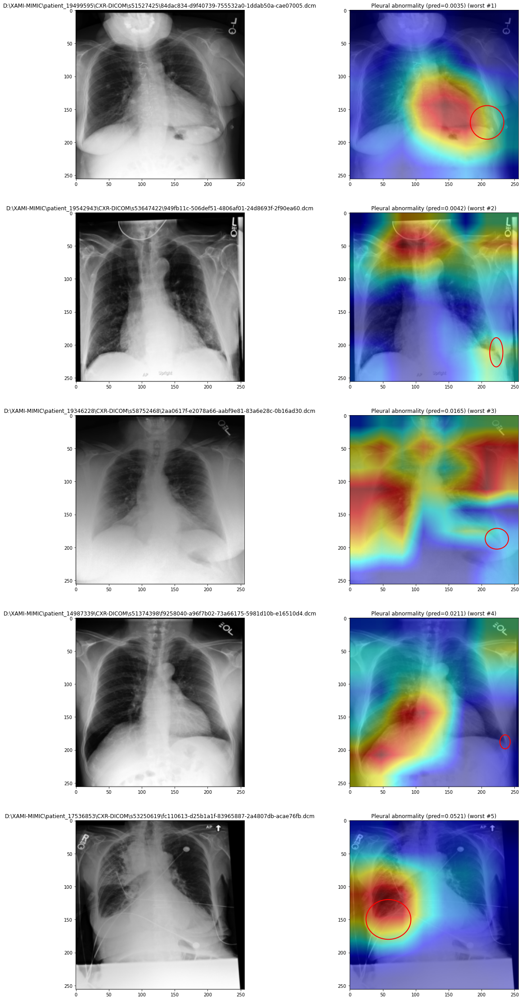

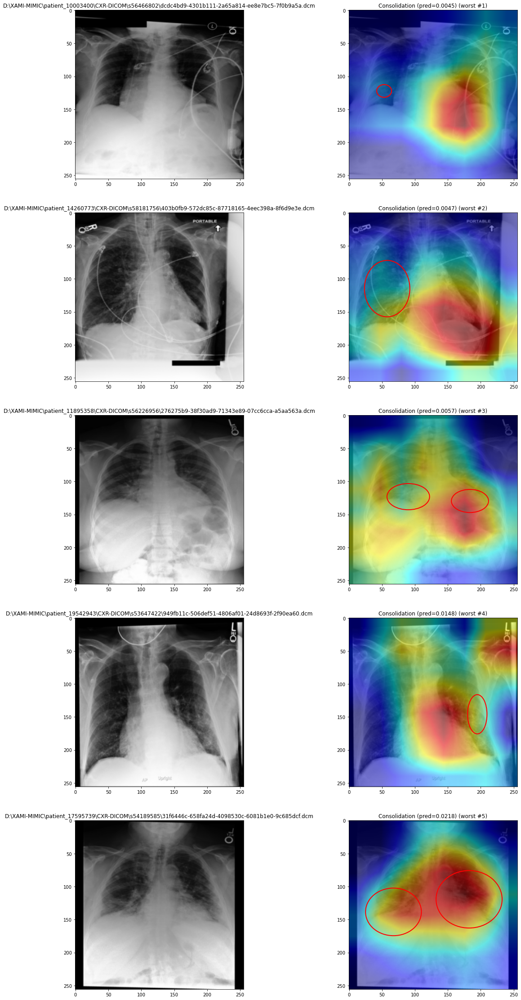

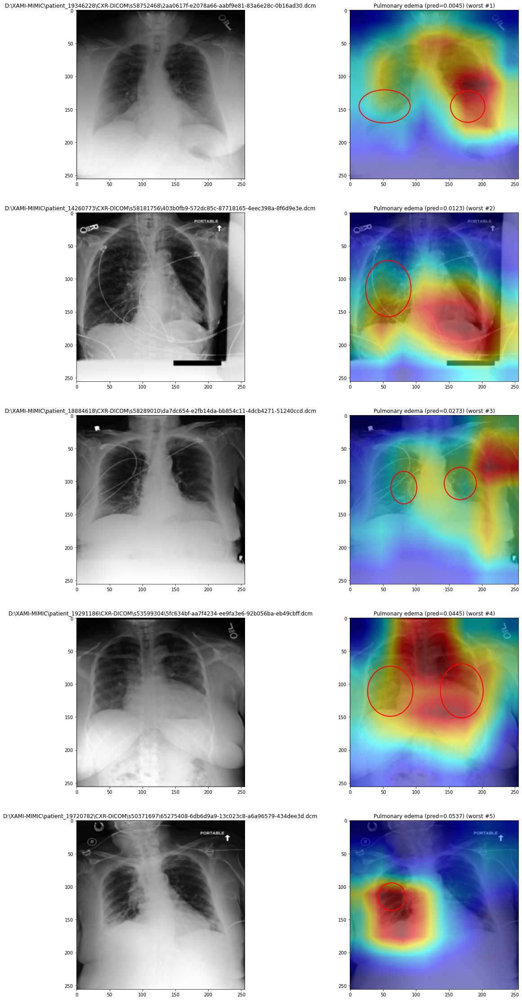

In [20]:
plot_best_worst(combined_df, reflacx_dataset, cxr_model, cxr_prefix,
                "worst", top_num, best_worst_cases, loss_fn, device)


# Best Cases for CXR+Clinical model

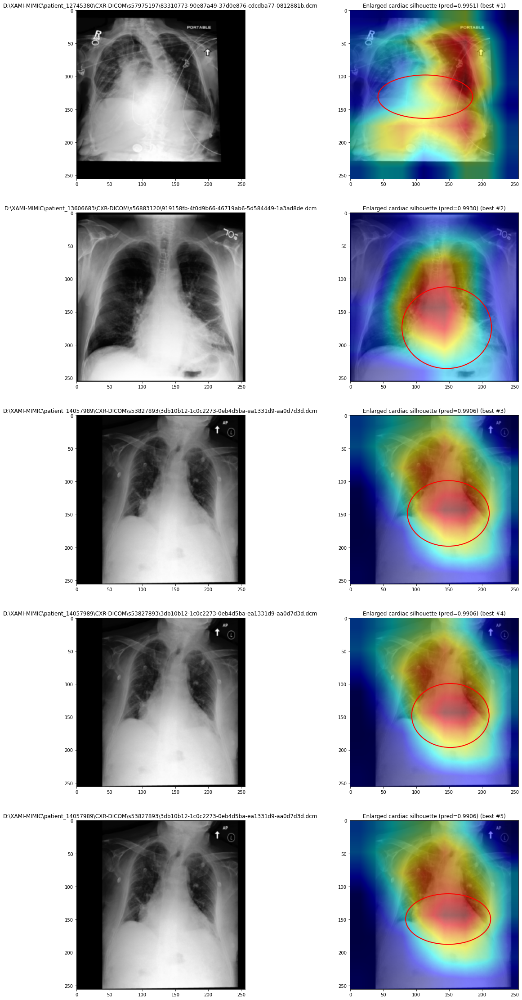

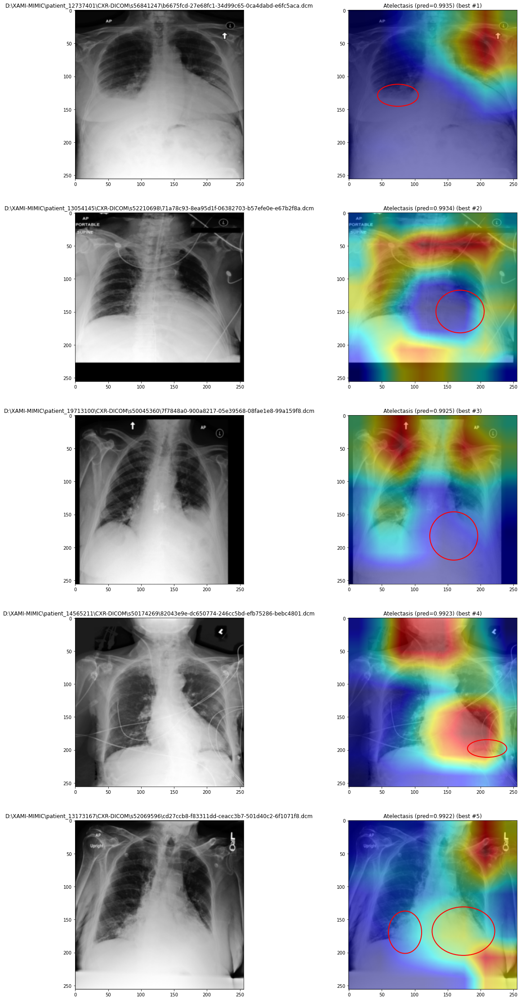

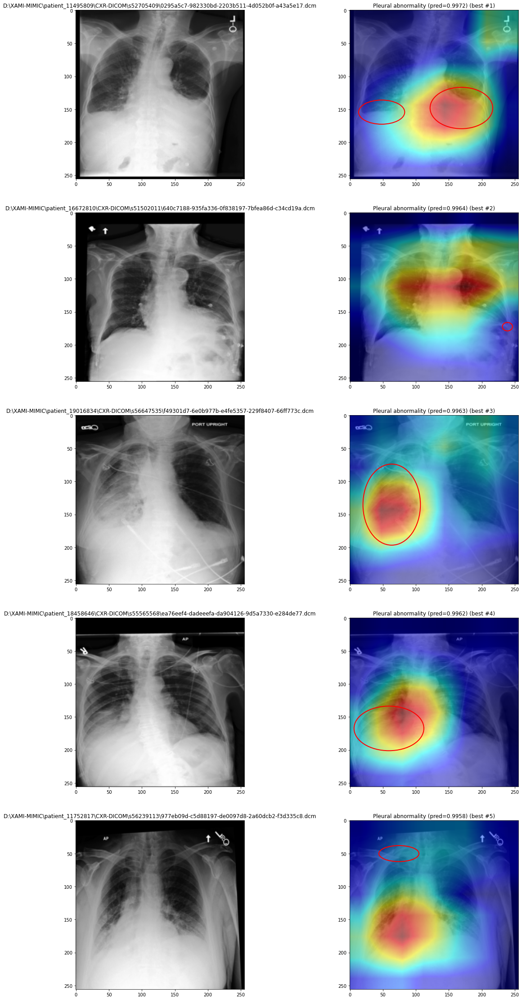

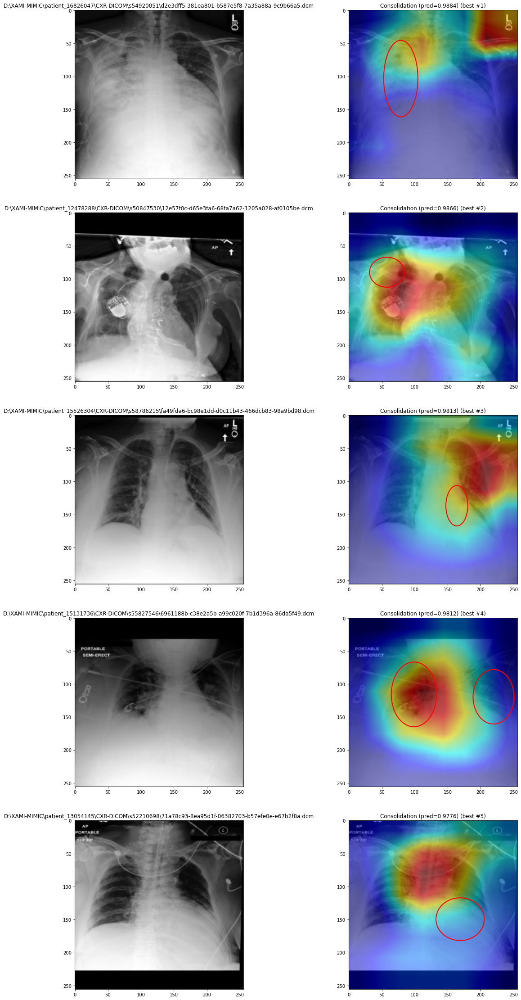

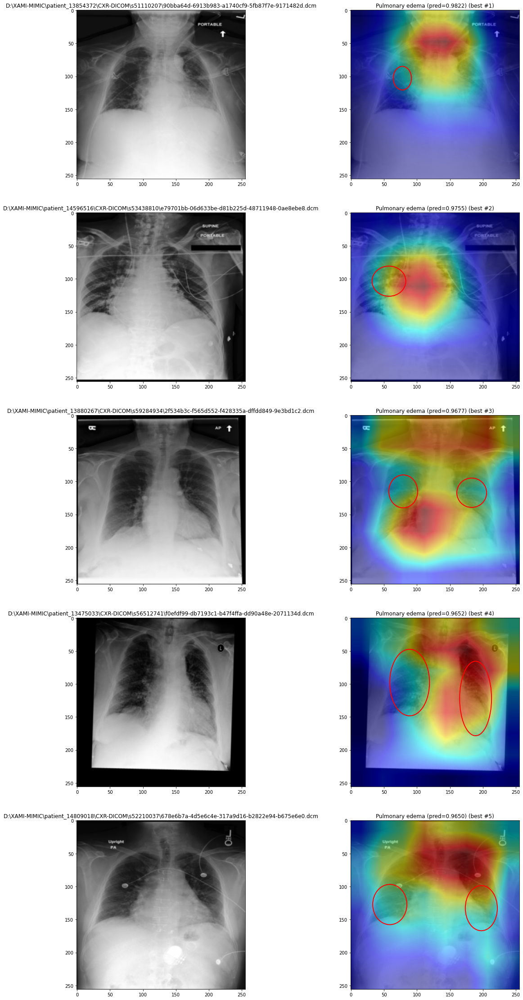

In [21]:
plot_best_worst(combined_df, reflacx_dataset, cxr_clinical_model, cxr_clinical_prefix,
                "best", top_num, best_worst_cases, loss_fn, device)


# Worst Cases for CXR+Clinical model

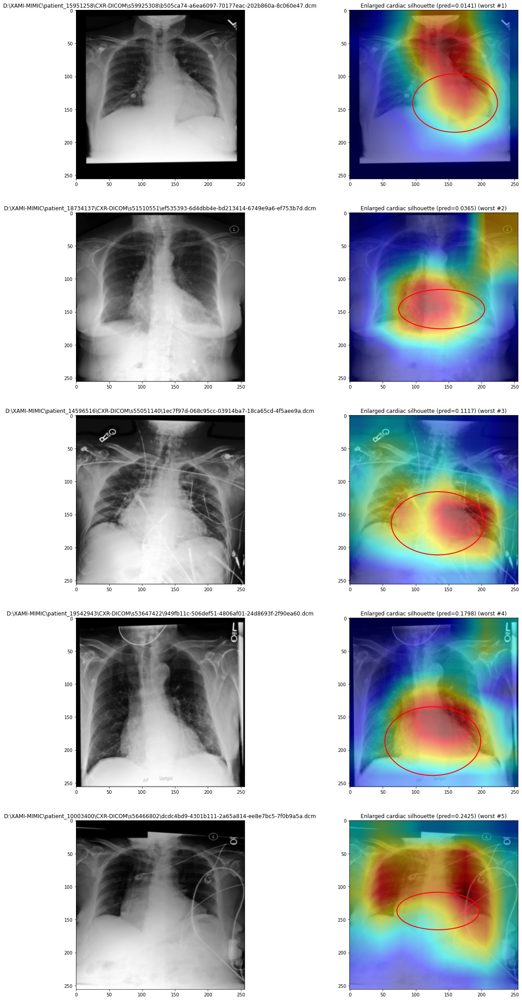

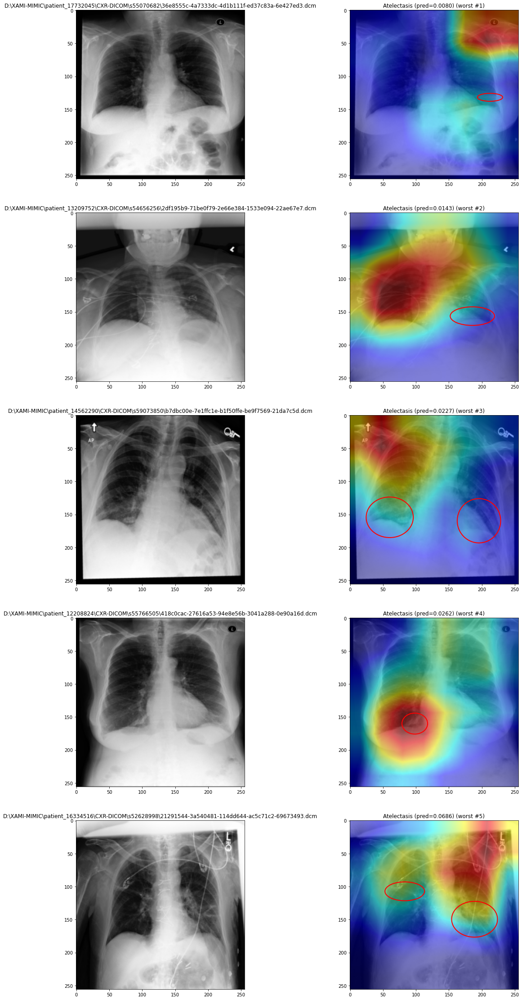

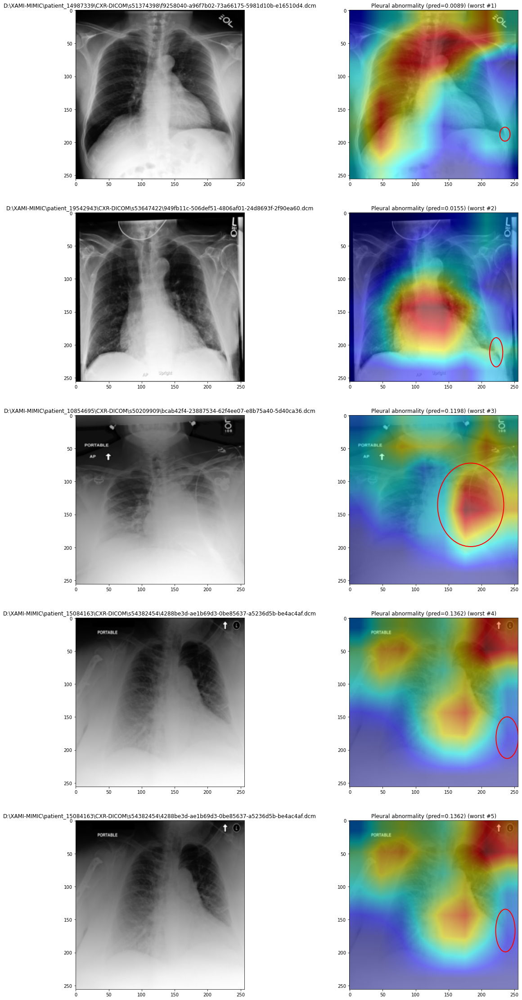

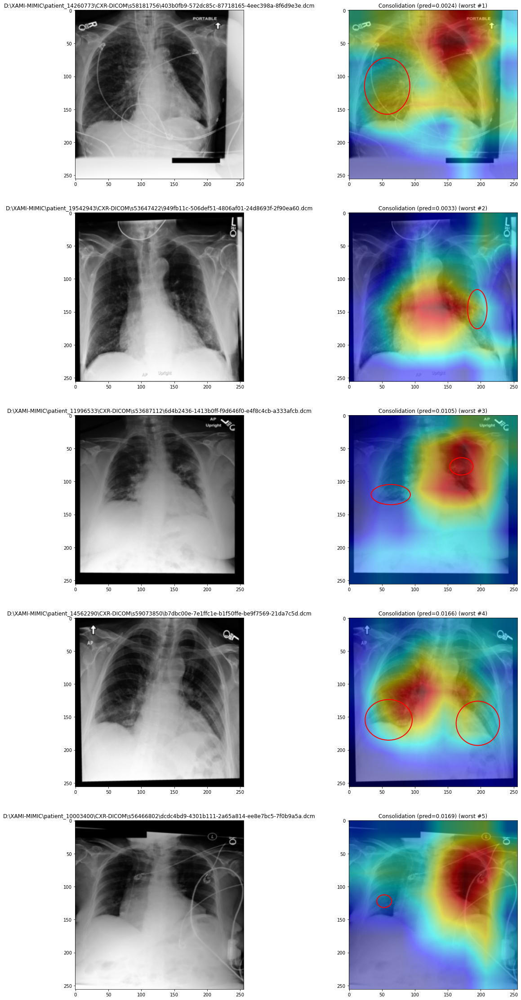

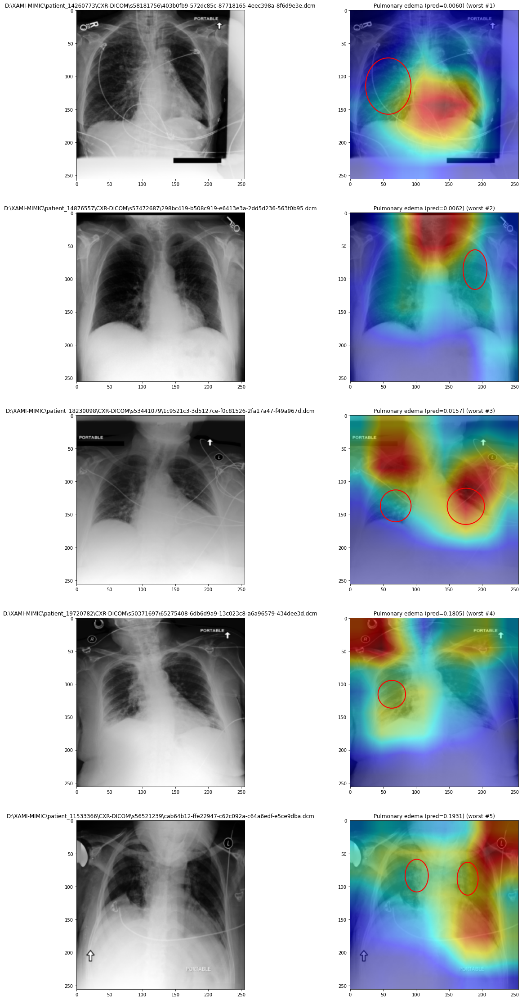

In [22]:
plot_best_worst(combined_df, reflacx_dataset, cxr_clinical_model, cxr_clinical_prefix,
                "worst", top_num, best_worst_cases, loss_fn, device)